## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')


# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
    
    #print ('gray.shape', gray.shape)
    #print ('gray.shape[::-1]', gray.shape[::-1])

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
        
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

### Nice reference to read
*  https://docs.opencv.org/2.4/modules/calib3d/doc/camera_calibration_and_3d_reconstruction.html#cv2.findChessboardCorners
* http://www.cse.psu.edu/~rtc12/CSE486/lecture12.pdf
* http://wycwang.blogspot.tw/2012/10/camera-calibration-part-2-calibration.html


* https://stackoverflow.com/questions/41430791/python-list-error-1-step-on-1-slice
        
    >>> a = list(range(10))
    >>> a
    [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
    
    >>> a[:-1]
    [0, 1, 2, 3, 4, 5, 6, 7, 8]
    
    >>> a[::-1]
    [9, 8, 7, 6, 5, 4, 3, 2, 1, 0]
    
    >>> a[:-1:-1]
    []


## Camera calibration, given object points, image points, and the shape of the grayscale image:


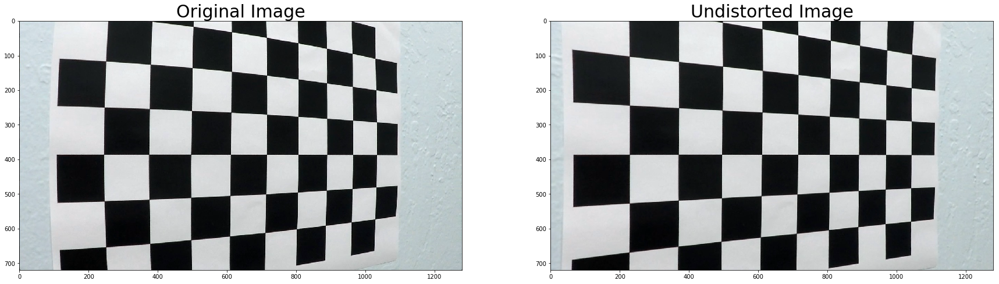

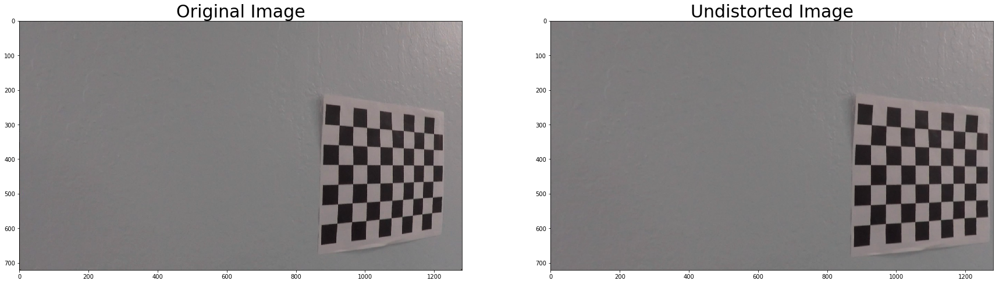

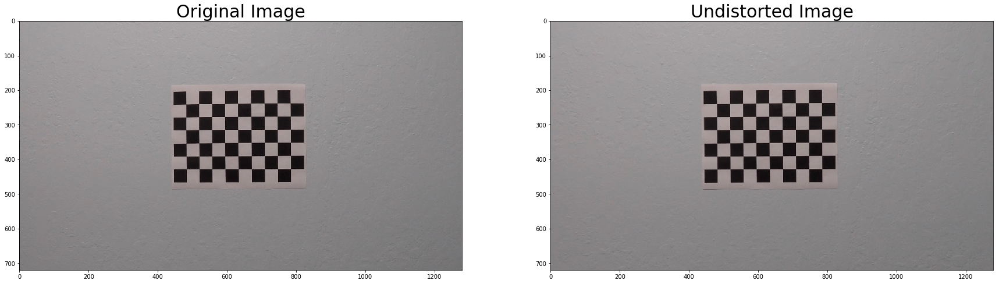

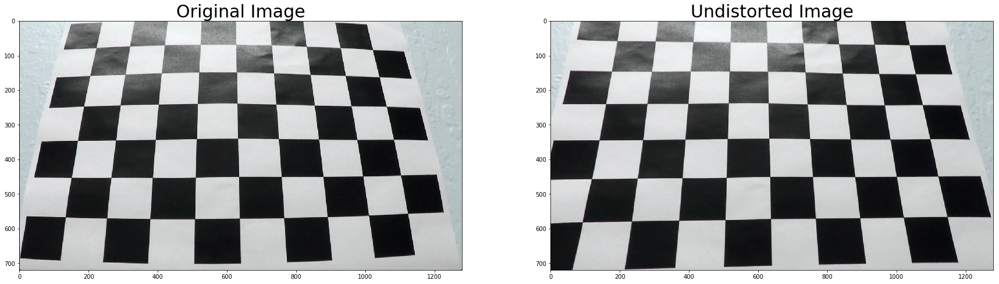

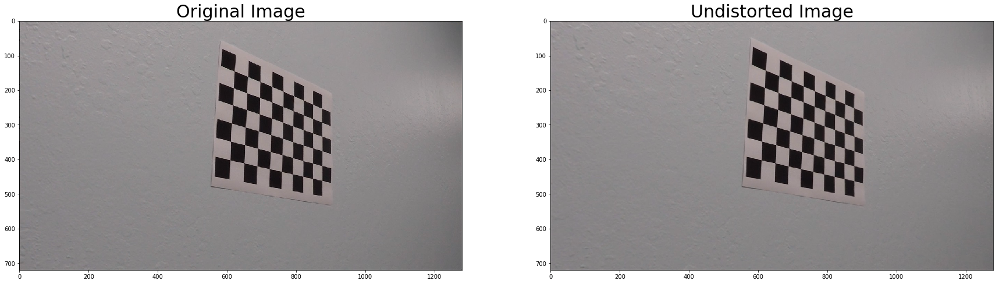

...

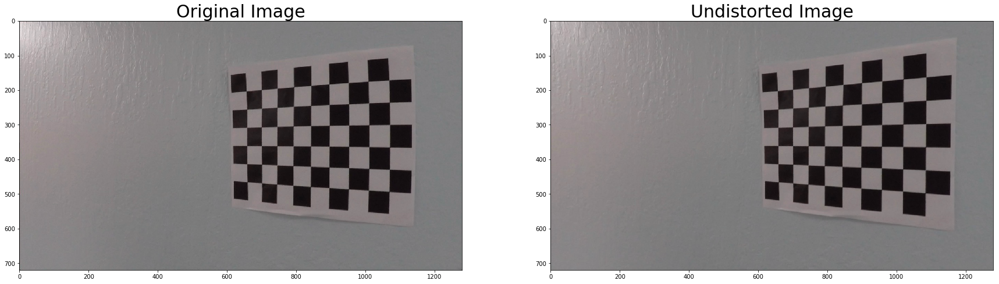

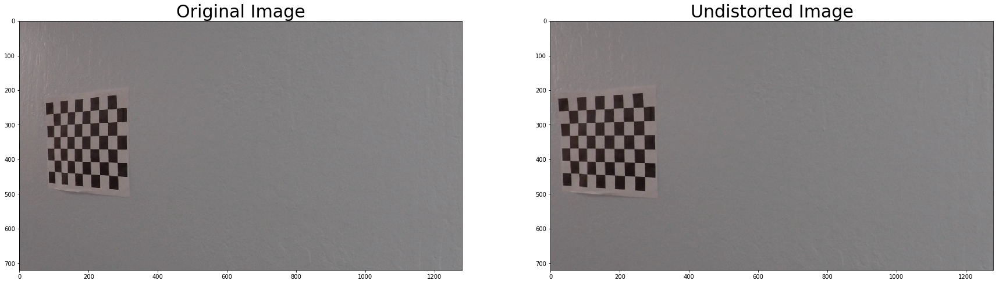

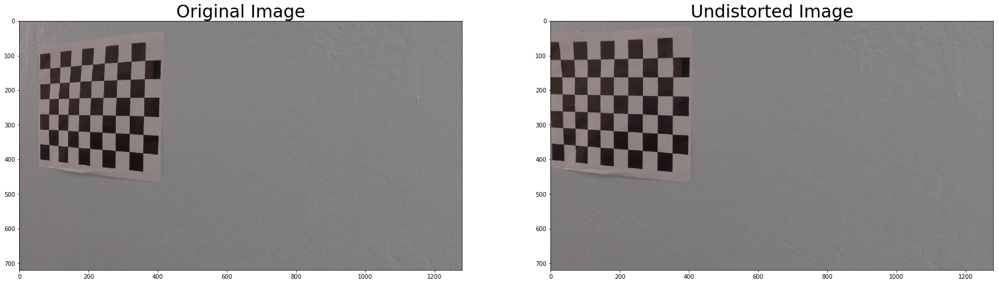

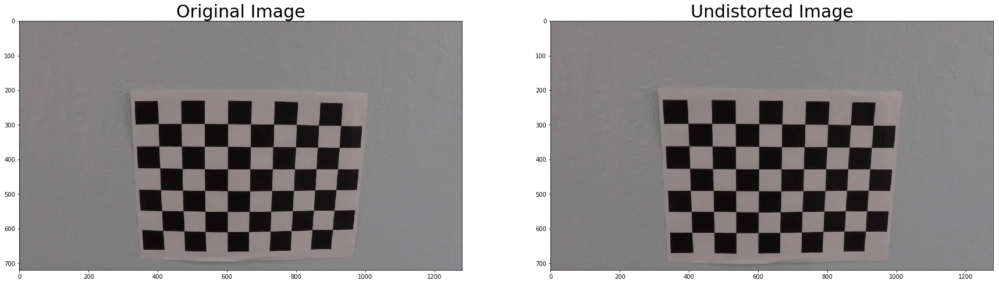

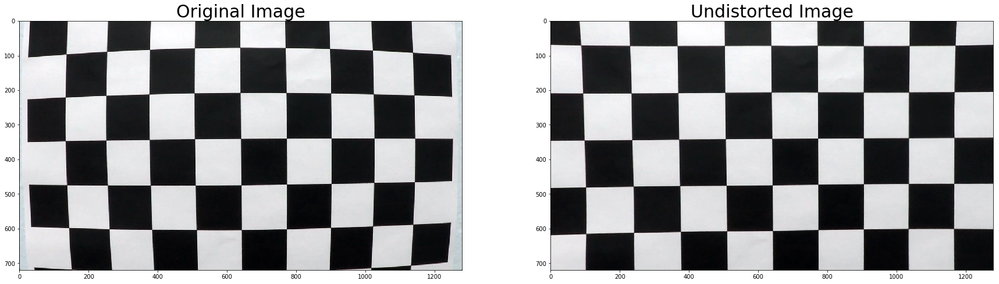

In [2]:
import pickle
%matplotlib inline

# Test undistortion on an image
#img = cv2.imread('../camera_cal/calibration19.jpg')
#img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
#ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


images = glob.glob('../camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    #undistorted
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    fname_dst = fname.replace("camera_cal", "camera_cal_undist")
    cv2.imwrite(fname_dst, dst)

    # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
    dist_pickle = {}
    dist_pickle["mtx"] = mtx
    dist_pickle["dist"] = dist
    
    #pickle.dump( dist_pickle, open( "calibration_cal/wide_dist_pickle.p", "wb" ) )
    #dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    # Visualize undistortion
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,20))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)
    

    
   

## Provide an example of a distortion-corrected image.


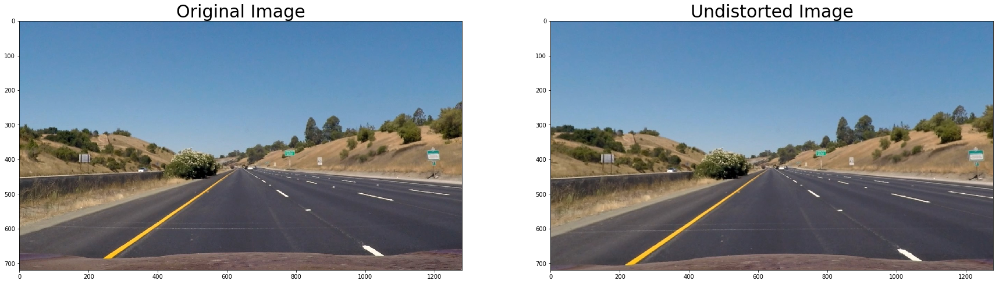

In [5]:
import matplotlib.image as mpimg
img = mpimg.imread('../test_images/straight_lines1.jpg')
undistort = cv2.undistort(img, mtx, dist, None, mtx)


f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,20))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undistort)
ax2.set_title('Undistorted Image', fontsize=30)

###  Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image.  Provide an example of a binary image result.

I used a combination of color and gradient thresholds to generate a binary image (thresholding steps at lines # through # in `another_file.py`).  Here's an example of my output for this step.  (note: this is not actually from one of the test images)

In [109]:
#Sobel X, Y implementation

def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255, sobel_kernel=3):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

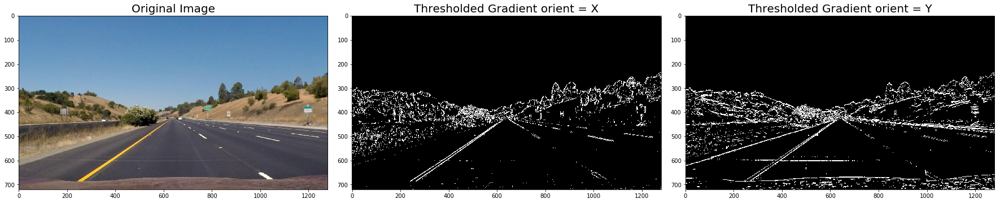

In [110]:
image = mpimg.imread('../test_images/straight_lines1.jpg')

# Run the function
grad_binary_x = abs_sobel_thresh(image, orient='x', thresh_min=20, thresh_max=100)
grad_binary_y = abs_sobel_thresh(image, orient='y', thresh_min=20, thresh_max=100)
# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=20)
ax2.imshow(grad_binary_x, cmap='gray')
ax2.set_title('Thresholded Gradient orient = X', fontsize=20)
ax3.imshow(grad_binary_y, cmap='gray')
ax3.set_title('Thresholded Gradient orient = Y', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#### Magnitude of the Gradient
$$ abs\_sobelx = \sqrt{(sobel_x)^2}$$
$$ abs\_sobely = \sqrt{(sobel_y)^2}$$
$$ abs\_sobelxy = \sqrt{(sobel_x)^2 + (sobel_y)^2}$$
 

In [111]:
#Sobel Magnitude
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

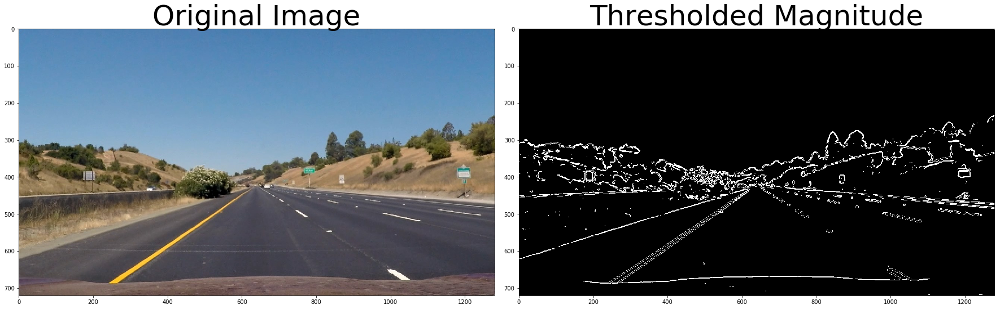

In [112]:
image = mpimg.imread('../test_images/straight_lines1.jpg')


# Run the function
mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(50, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
# Run the function


### Direction of the Gradient
$$ arctan(sobel_y/sobel_x). $$


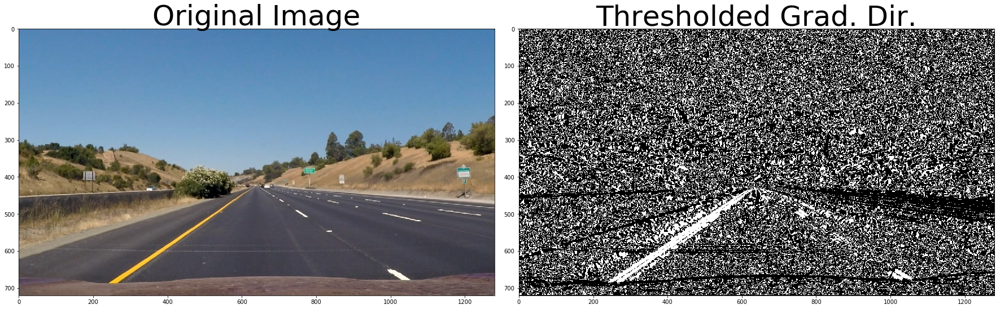

In [113]:
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

# Run the function
dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.2))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



### Combining Thresholds


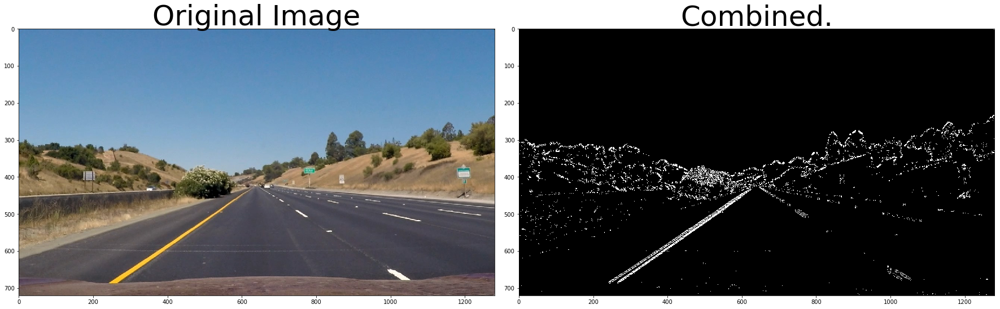

In [114]:
# Choose a Sobel kernel size
ksize = 15 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
#gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(0, 255))
#grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(0, 255))
gradx = abs_sobel_thresh(image, orient='x', thresh_min = 20, thresh_max = 100)
grady = abs_sobel_thresh(image, orient='y', thresh_min = 20, thresh_max = 100)

mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(50, 100))

dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(np.pi/4, np.pi/3))

combined = np.zeros_like(dir_binary)
#print (combined)

combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
#combined[((mag_binary == 1) & (dir_binary == 1))] = 1
#print (grad_binary_x)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Combined.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


### Color and Gradient


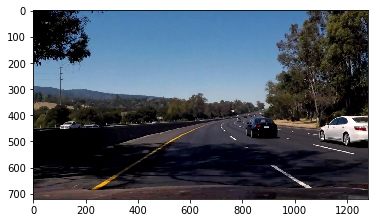

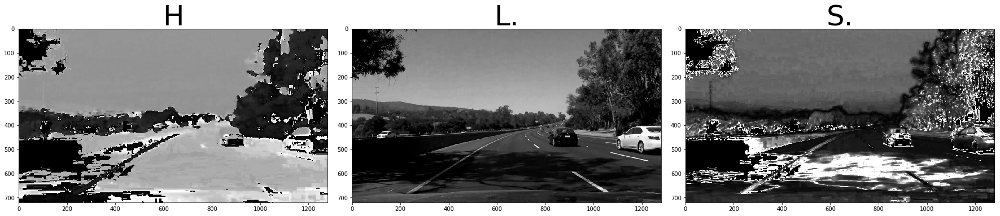

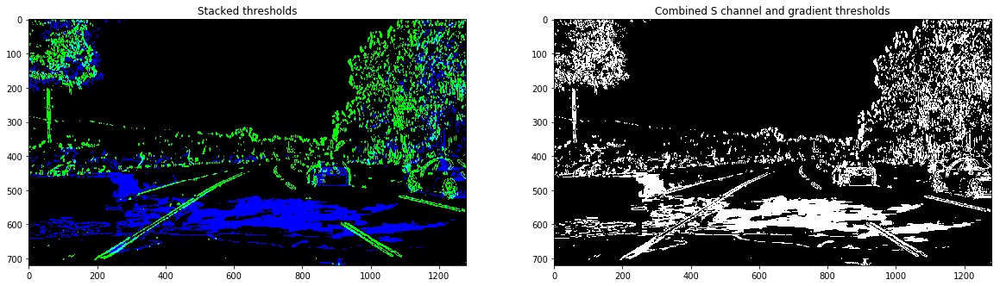

In [126]:
hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

plt.imshow(img)
plt.show()

H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]

f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()
ax1.imshow(H, cmap='gray')
ax1.set_title('H', fontsize=50)
ax2.imshow(L, cmap='gray')
ax2.set_title('L.', fontsize=50)
ax3.imshow(S, cmap='gray')
ax3.set_title('S.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#s_channel = S
# Threshold color channel
#s_thresh_min = 170
#s_thresh_max = 255
#s_binary = np.zeros_like(s_channel)
#s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1


# Define a function that thresholds the S-channel of HLS
def hls_select(img, thresh=(0, 255), channel='s'):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    if channel == 'h':
        s_channel = hls[:,:,0]
    elif channel == 'l':
        s_channel = hls[:,:,1]
    elif channel == 's':
        s_channel = hls[:,:,2]
    else:
        print ('assertion failed')
    
        
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

s_binary = hls_select(img, thresh=(170, 255))


# Stack each channel to view their individual contributions in green and blue respectively
# This returns a stack of the two binary images, whose components you can see as different colors
color_binary = np.dstack(( np.zeros_like(gradx), gradx, s_binary)) * 255

# Combine the two binary thresholds
combined_binary = np.zeros_like(gradx)
combined_binary[(s_binary == 1) | (gradx == 1)] = 1

# Plotting thresholded images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Stacked thresholds')
ax1.imshow(color_binary)

ax2.set_title('Combined S channel and gradient thresholds')
ax2.imshow(combined_binary, cmap='gray')


##  prespective transform
* https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_imgproc/py_geometric_transformations/py_geometric_transformations.html

In [127]:
def warper(img, src, dst):

    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
     
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image

    return warped


(1280, 720)
[[  580.           460.        ]
 [  203.33332825   720.        ]
 [ 1119.66662598   720.        ]
 [  701.           460.        ]]
[[ 320.    0.]
 [ 320.  720.]
 [ 960.  720.]
 [ 960.    0.]]


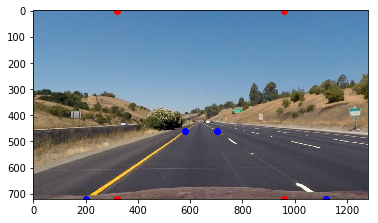

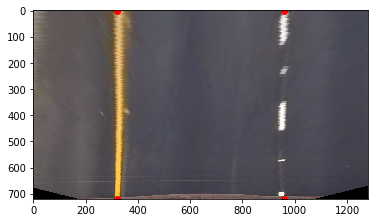

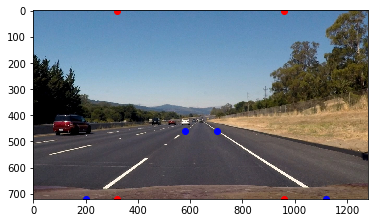

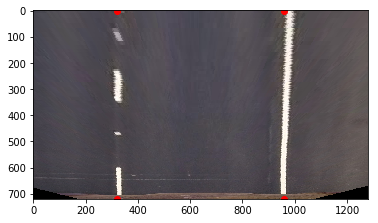

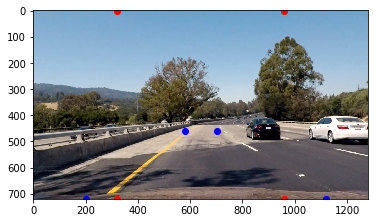

...

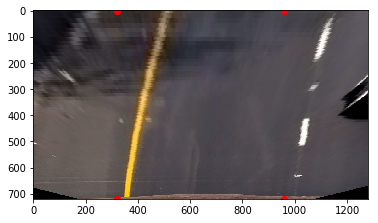

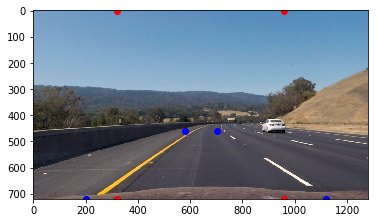

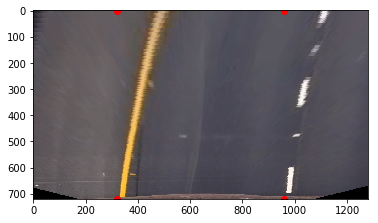

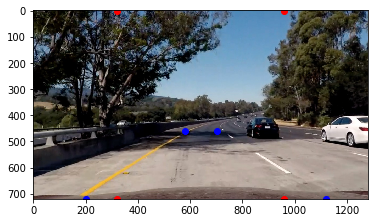

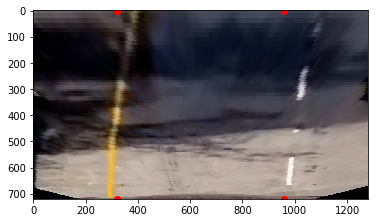

In [128]:

import matplotlib.patches as patches


def plot_label (src, marker):
    for src_x, src_y in src:
        plt.plot(src_x, src_y, marker)
        

img = mpimg.imread('../test_images/straight_lines1.jpg')
img = cv2.undistort(img, mtx, dist, None, mtx)

img_size = (img.shape[1], img.shape[0])
print (img_size)

src = np.float32(
[[(img_size[0] / 2) - 60, img_size[1] / 2 + 100],
[((img_size[0] / 6) - 10), img_size[1]],
[(img_size[0] * 5 / 6) + 53, img_size[1]],
[(img_size[0] / 2 + 61), img_size[1] / 2 + 100]])
    
dst = np.float32(
[[(img_size[0] / 4), 0],
[(img_size[0] / 4), img_size[1]],
[(img_size[0] * 3 / 4), img_size[1]],
[(img_size[0] * 3 / 4), 0]])

print(src)
print(dst)


'''
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])
'''
#f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,20))
#ax1.imshow(img)
#rect = patches.Rectangle(src,linewidth=1,edgecolor='r',facecolor='none')
#ax1.add_patch(rect)
#ax1.set_title('Original Image', fontsize=30)
#ax2.imshow(dst)
#ax2.set_title('Warped Image', fontsize=30)



    

def plot_orig_and_warped(src, dst, img):
    plot_label(src, 'bo')
    plot_label(dst, 'ro')
    plt.imshow(img)
    plt.show()
    warped = warper(img, src, dst)
    plot_label(dst, 'ro')
    plt.imshow(warped)
    plt.show()

plot_orig_and_warped(src, dst, img)

img = mpimg.imread('../test_images/straight_lines2.jpg')
plot_orig_and_warped(src, dst, img)


#plt.plot(src[0][0], src[0][1], 'bo')
#plt.plot(src[1][0], src[1][1], 'bo')
#plt.plot(src[2][0], src[2][1], '.')
#plt.plot(src[3][0], src[3][1], '.')
#plt.plot(src.flatten(), 'bo')
images = glob.glob('../test_images/test*.jpg')

# Step through the test_images
for fname in images:
    img = mpimg.imread(fname)
    img = cv2.undistort(img, mtx, dist, None, mtx)

    plot_orig_and_warped(src, dst, img)



### Processing pipeline

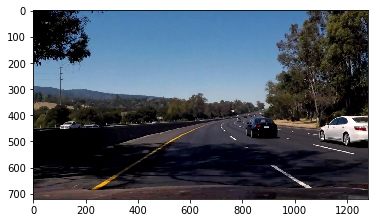

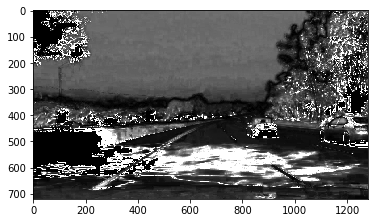

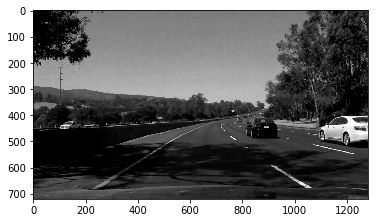

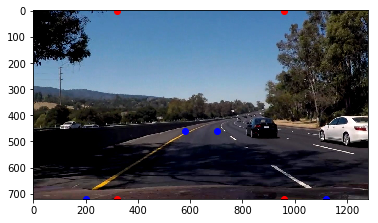

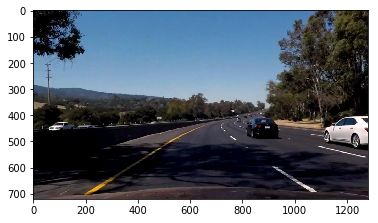

...

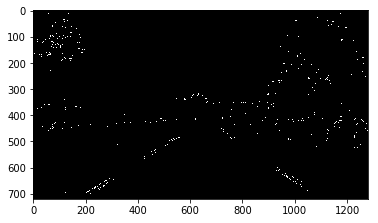

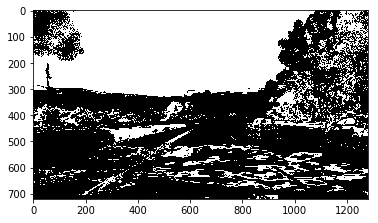

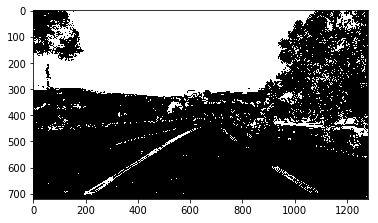

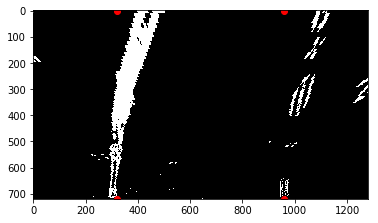

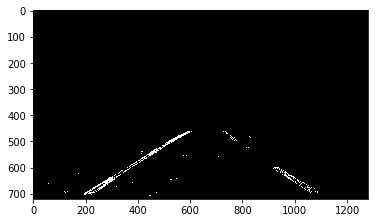

In [217]:
img = mpimg.imread('../test_images/straight_lines1.jpg')
img = mpimg.imread('../test_images/test5.jpg')
#img = mpimg.imread('../failed_test_images/failed.jpg')
img = mpimg.imread('../failed_test_images/failed_2.jpg')

hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

plt.imshow(img)
plt.show()

H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]

plt.imshow(S,cmap='gray')
plt.show()

plt.imshow(L,cmap='gray')
plt.show()


## camera undistort 
image = cv2.undistort(img, mtx, dist, None, mtx)
## Combined Threshold
gradx = abs_sobel_thresh(image, orient='x', thresh_min = 20, thresh_max = 100, sobel_kernel=ksize)
grady = abs_sobel_thresh(image, orient='y', thresh_min = 20, thresh_max = 100, sobel_kernel=ksize)
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(50, 100))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(np.pi/4, np.pi/3))

s_binary = hls_select(image, thresh=(70, 180))

l_binary = hls_select(image, thresh=(40, 255), channel = 'l')

combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | s_binary == 1] = 1






plot_label(src, 'bo')
plot_label(dst, 'ro')
plt.imshow(img)
plt.show()

plt.imshow(image)
plt.show()

combined = np.zeros_like(dir_binary)
combined[l_binary==1] = 1
plt.imshow(combined,cmap='gray')
plt.show()


combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1))] = 1
plt.imshow(combined,cmap='gray')
plt.show()

combined = np.zeros_like(dir_binary)
combined[((gradx == 1)| s_binary == 1)] = 1
plt.imshow(combined,cmap='gray')
plt.show()

combined = np.zeros_like(dir_binary)
combined[((mag_binary == 1) & (dir_binary == 1))] = 1
plt.imshow(combined,cmap='gray')
plt.show()

combined = np.zeros_like(dir_binary)
combined[s_binary == 1] = 1
plt.imshow(combined,cmap='gray')
plt.show()


combined = np.zeros_like(dir_binary)
#combined[((mag_binary == 1) & (dir_binary == 1)) | ((s_binary == 1) & (l_binary ==1))] = 1
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | ((s_binary == 1) & (l_binary ==1))] = 1

plt.imshow(combined,cmap='gray')
plt.show()

warped = warper(combined, src, dst)


un_warped = warper(warped, dst, src)


plot_label(dst, 'ro')
plt.imshow(warped, cmap='gray')
plt.show()



plt.imshow(un_warped, cmap='gray')
plt.show()

### Line Finding Method: Peaks in a Histogram



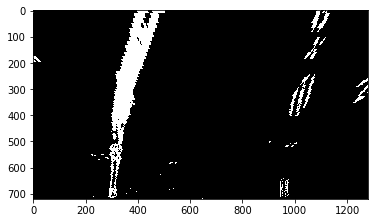

720
360
[[2 0 0]
 [3 0 0]
 [3 1 0]
 [5 0 0]
 [5 1 0]
 [5 2 0]]
[23  4  0]


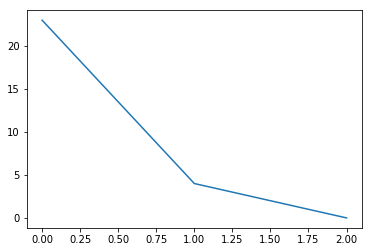

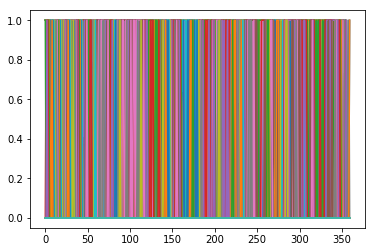

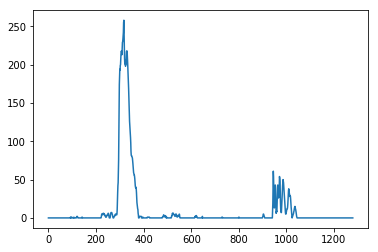

In [218]:
import numpy as np
plt.imshow(warped, cmap='gray')
plt.show()

# Try to understand what is
# plt.plot(img[img.shape[0]//2:,:])

print(img.shape[0])
print(img.shape[0]//2)
## https://stackoverflow.com/questions/183853/in-python-2-what-is-the-difference-between-and-when-used-for-division

a = np.array([[2,0,0],[3,0,0],[3,1,0],[5,0,0],[5,1,0],[5,2,0]])
print(a)

histogram = np.sum(a[:,:], axis=0)
#histogram = np.sum(a[:,:], axis=1)
print(histogram)
plt.plot(histogram)
plt.show()


img = warped



plt.plot(img[img.shape[0]//2:,:])
plt.show()
histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
plt.plot(histogram)
plt.show()

#### Implement Sliding Windows and Fit a Polynomial

(720, 0)

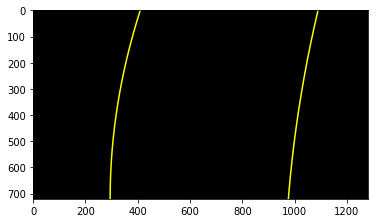

In [211]:
binary_warped = warped
# Assuming you have created a warped binary image called "binary_warped"
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]//2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]//nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)


#Visualization

# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)


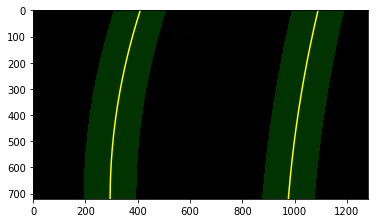

In [212]:
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))


# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)

plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)
plt.show()

In [213]:
'''


import numpy as np
import matplotlib.pyplot as plt
# Generate some fake data to represent lane-line pixels
ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
quadratic_coeff = 3e-4 # arbitrary quadratic coefficient
# For each y position generate random x position within +/-50 pix
# of the line base position in each case (x=200 for left, and x=900 for right)
leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                              for y in ploty])
rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                for y in ploty])


leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
rightx = rightx[::-1]  # Reverse to match top-to-bottom in y


# Fit a second order polynomial to pixel positions in each fake lane line
left_fit = np.polyfit(ploty, leftx, 2)
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fit = np.polyfit(ploty, rightx, 2)
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]



# Plot up the fake data
mark_size = 3
plt.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
plt.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, ploty, color='green', linewidth=3)
plt.plot(right_fitx, ploty, color='green', linewidth=3)
plt.gca().invert_yaxis() # to visualize as we do the images
'''

"\n\n\nimport numpy as np\nimport matplotlib.pyplot as plt\n# Generate some fake data to represent lane-line pixels\nploty = np.linspace(0, 719, num=720)# to cover same y-range as image\nquadratic_coeff = 3e-4 # arbitrary quadratic coefficient\n# For each y position generate random x position within +/-50 pix\n# of the line base position in each case (x=200 for left, and x=900 for right)\nleftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) \n                              for y in ploty])\nrightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) \n                                for y in ploty])\n\n\nleftx = leftx[::-1]  # Reverse to match top-to-bottom in y\nrightx = rightx[::-1]  # Reverse to match top-to-bottom in y\n\n\n# Fit a second order polynomial to pixel positions in each fake lane line\nleft_fit = np.polyfit(ploty, leftx, 2)\nleft_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]\nright_fit = np.polyfit(ploty, 

In [214]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
# Example values: 1926.74 1908.48

# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 632.1 m    626.2 m

2259.17694645 4689.063621


TypeError: expected x and y to have same length

In [215]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

[[  580.           460.        ]
 [  203.33332825   720.        ]
 [ 1119.66662598   720.        ]
 [  701.           460.        ]]
[[ 320.    0.]
 [ 320.  720.]
 [ 960.  720.]
 [ 960.    0.]]
1280


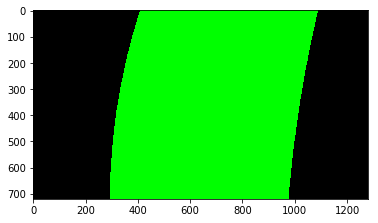

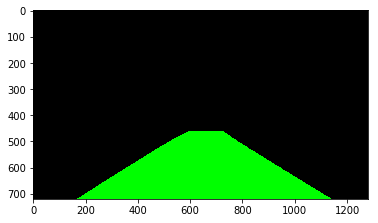

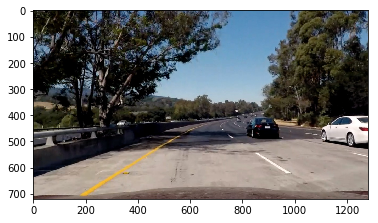

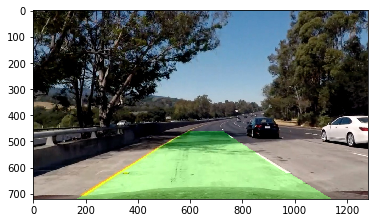

In [216]:
Minv = cv2.getPerspectiveTransform(dst, src) # Inverse transformation

print(src)
print(dst)

img = mpimg.imread('../test_images/test5.jpg')
#img = mpimg.imread('../failed_test_images/failed.jpg')
#img = mpimg.imread('../failed_test_images/failed_2.jpg')


undist = cv2.undistort(img, mtx, dist, None, mtx)
image = img

print(image.shape[1])

# Create an image to draw the lines on
warp_zero = np.zeros_like(warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

plt.imshow(color_warp)
plt.show()


# Warp the blank back to original image space using inverse perspective matrix (Minv)
#newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

newwarp = warper(color_warp, dst, src)


plt.imshow(newwarp)
plt.show()

plt.imshow(undist)
plt.show()

# Combine the result with the original image
result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
plt.imshow(result)

## Test on Videos

### Input: project_video.mp4


In [177]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [219]:
def process_image(image):
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    
    
    ## Combined Threshold
    gradx = abs_sobel_thresh(undist, orient='x', thresh_min = 20, thresh_max = 100)
    grady = abs_sobel_thresh(undist, orient='y', thresh_min = 20, thresh_max = 100)
    mag_binary = mag_thresh(undist, sobel_kernel=ksize, mag_thresh=(50, 100))
    dir_binary = dir_threshold(undist, sobel_kernel=ksize, thresh=(np.pi/4, np.pi/3))
    
    #s_binary = hls_select(undist, thresh=(170, 195))
    s_binary = hls_select(image, thresh=(60, 255))
    l_binary = hls_select(image, thresh=(40, 255), channel = 'l')



    
    combined = np.zeros_like(dir_binary)
    #combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | s_binary == 1] = 1
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1)) | ((s_binary == 1) & (l_binary ==1))] = 1


    warped = warper(combined, src, dst)

    
    
    binary_warped = warped
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    #=============================================================================
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))



    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    #newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

    newwarp = warper(color_warp, dst, src)

    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)

    return result

In [220]:
input_video = '../project_video.mp4'
#input_video = '../challenge_video.mp4'
output_video = '../project_video_output.mp4'

clip1 = VideoFileClip(input_video)
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(output_video, audio=False)

[MoviePy] >>>> Building video ../project_video_output.mp4
[MoviePy] Writing video ../project_video_output.mp4


100%|█████████▉| 1260/1261 [06:33<00:00,  3.28it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../project_video_output.mp4 

CPU times: user 21min 7s, sys: 2.44 s, total: 21min 9s
Wall time: 6min 34s
Parser   : 100 ms


In [221]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))